# Preprocessing BOLD

In this notebook, we will examine the preprocessed fMRI data and create the workflow using a particular subject (subject 1). We will load the data, regress confounds, detrend, despike, normalize and reduce the dimensionality by cropping. The pipeline will be as follows:

* regress out the confounds for each run
* despike the extreme values
* normalize for each session
* average the timeseries for each stimulus

In [2]:
from packages import *
import time
%matplotlib inline

In [3]:
from collections import Counter
import sklearn

### Process for a single subject

In [3]:
subject = 3
threshold = 3. #in standard deviations
func_files_req = ['preproc', 'confounds']
datasets = {}
func_dir = os.path.join(DUMP_DIR, get_subject_dir(subject), 'func/')
if not os.path.isdir(func_dir):
    os.mkdir(func_dir)
bold_dir = os.path.join(func_dir, 'bold')
if not os.path.isdir(bold_dir):
    os.mkdir(bold_dir)
anat_file = load_file(os.path.join(DATA_DIR, get_subject_dir(subject), 'anat/', 'sub-CSI{}_T1w_preproc.nii.gz'.format(subject)))[0]

In [ ]:
def get_confound_indexes(gsr):
    confounds = ['CSF', 'WhiteMatter', 'stdDVARS',
                        'FramewiseDisplacement', 'tCompCor00', 'tCompCor01',
                        'tCompCor02', 'tCompCor03', 'tCompCor04', 'tCompCor05', 
                        'aCompCor00','aCompCor01', 'aCompCor02', 'aCompCor03', 
                        'aCompCor04', 'aCompCor05',
                        'Cosine00', 'Cosine01', 'Cosine02', 'Cosine03', 'Cosine04', 'X', 
                        'Y', 'Z', 'RotX', 'RotY', 'RotZ',
                        'X_deriv', 'Y_deriv', 'Z_deriv', 'RotX_deriv', 'RotY_deriv',
                        'RotZ_deriv']
    if gsr:
        confounds.append('GlobalSignal')
    return confounds

In [4]:
def get_func_files(subject, session, func_files, mode, affine = None):
    if affine is None:
        affine = False
    sub_dir = os.path.join(DATA_DIR, get_subject_dir(subject))
    session_dir = os.path.join(sub_dir, get_session_dir(session), 'func/')
    if mode == 'filename': 
        output_filenames = {}
        for f in os.listdir(session_dir):
            if 'localizer' in f:
                continue
            for req in func_files:
                if req in f:
                    f_path = os.path.join(session_dir, f)
                    run = extract_run(f)
                    if run not in output_filenames:
                        output_filenames[run] = {}
                    output_filenames[run][req] = f_path
        return output_filenames    
    elif mode == 'imgs':
        output_imgs = {}
        for f in os.listdir(session_dir):
            if 'localizer' in f:
                continue
            for req in func_files:
                if req in f:
                    f_path = os.path.join(session_dir, f)
                    run = extract_run(f)
                    data = load_file(f_path)
                    if data[1] == 'nibabel':
                        arr = data[0]
                    elif data[1] == 'pandas':
                        arr = data[0]
                    if run not in output_imgs:
                        output_imgs[run] = {}
                    output_imgs[run][req] = arr
        return output_imgs        
    elif mode == 'arrays':
        output_arrays = {}
        for f in os.listdir(session_dir):
            if 'localizer' in f:
                continue
            for req in func_files:
                if req in f:
                    f_path = os.path.join(session_dir, f)
                    run = extract_run(f)
                    data = load_file(f_path)
                    if data[1] == 'nibabel':
                        arr = {}
                        arr['data'] = data[0].get_fdata()
                        if affine:
                            arr['affine'] = data[0].affine
                    elif data[1] == 'pandas':
                        arr = {'data': data[0]}
                    if run not in output_arrays:
                        output_arrays[run] = {}
                    output_arrays[run][req] = arr
        return output_arrays   
    elif mode == 'filename+arrays':
        output_arrays = {}
        output_filenames = {}
        for f in os.listdir(session_dir):
            if 'localizer' in f:
                continue
            for req in func_files:
                if req in f:
                    f_path = os.path.join(session_dir, f)
                    run = extract_run(f)
                    data = load_file(f_path)
                    if data[1] == 'nibabel':
                        arr = {}
                        arr['data'] = data[0].get_fdata()
                        if affine:
                            arr['affine'] = data[0].affine
                    elif data[1] == 'pandas':
                        arr = {'data': data[0]}
                    if run not in output_arrays:
                        output_filenames[run] = {}
                        output_arrays[run] = {}
                    output_arrays[run][req] = arr
                    output_filenames[run][req] = f_path
        return output_arrays, output_filenames
    else:
        raise Exception('unknown mode encountered: {}'.format(mode))

In [5]:
func_files = []
for ses in SESSIONS:
    func_files.append(get_func_files(subject, ses, func_files_req, 'imgs', affine = True))

#### Just for clear mind, let's check that all the images from all the sessions rest on the same native space by comparing the associated affine matrix with each image.

In [6]:
affine = func_files[0][1]['preproc'].affine
for i, ses in enumerate(func_files):
    for run in ses:
        assert np.array_equal(affine, ses[run]['preproc'].affine)

## Let's begin the preprocessing pipeline.

In [7]:
def prepare_confounds(confounds_raw):
    confounds=confounds_raw.fillna(0.)
    # add temporal derivatives of motion estimates
    motionvars=['X', 'Y', 'Z', 'RotX', 'RotY', 'RotZ']
    for v in motionvars:
        confounds['%s_deriv'%v]=0.
        confounds['%s_deriv'%v].iloc[1:]=confounds[v].iloc[1:].values - confounds[v].iloc[:-1].values
    return confounds

In [8]:
def regress_confounds(data, confounds, gsr): #CHECKED
    confounds_to_include = get_confound_indexes(gsr)
    confounds_data = np.nan_to_num(np.array(confounds.loc[:, confounds_to_include]))
    ''' 
    BUG: some confounds files don't have the column 'cosine4' which causes the confounds_data to be infected with np.nan's.
    Quick, naive workaround is to run fillna(0.) again after filling confounds_data
    '''
    lr=sklearn.linear_model.LinearRegression(fit_intercept=False)
    lr.fit(confounds_data, data)
    pred = lr.predict(confounds_data)
    regressed_data = data - pred
    assert data.shape == pred.shape
    assert data[10][10] - pred[10][10] == regressed_data[10][10]
    return regressed_data

In [9]:
def despike(data, mean):
    # ADD FRAMEWISE DISPLACEMENT HERE
    mean = np.mean(data)
    std = np.std(data)
    data[np.where(data > mean + threshold * std)] = mean + threshold * std
    data[np.where(data < mean - threshold * std)] = mean - threshold * std

In [10]:
def organize_data_for_run(run):
    confounds = prepare_confounds(run['confounds']) #prepare confounds
    d = run['preproc'].get_fdata()
    shp = d.shape
    flats = []
    for i in xrange(shp[3]):
        flats.append(d[:,:,:,i].flatten())
    flats = np.array(flats)
    d = regress_confounds(flats, confounds, gsr = True)
    reshaped = np.zeros(shp)
    for i in xrange(shp[3]):
        reshaped[:,:,:,i] = (d[i,:].reshape(shp[:-1]))
    reshaped = reshaped[:, :, :, 3:-6] #get rid of rest data.
    return reshaped

In [11]:
def average_timeseries(data):
    #data has shape (101|9, 72, 88, 67, 185)
    shp = data.shape
    averaged = np.zeros((shp[0]*shp[4]//5, shp[1], shp[2], shp[3]))
    assert shp[4]/TP_PER_STIM == 37
    TR = 5
    for j in xrange(shp[0]):
        for i in xrange(37):
            averaged[i + j*37, :, :, :] = np.average(data[j, :, :, :, i*TR : (i+1)*TR], axis=3, weights=[.05, .15, .35, .35, .1])
    return averaged

In [12]:
p = Pool(NUM_CPUS-2)

/usr/local/lib/python2.7/dist-packages/pandas/core/indexing.py:1472: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return self._getitem_tuple(key)


In [13]:
def preprocess(ses):
    #due to func_files being a list starting at index 0, increment by 1 when saving.
    print '-began ses-{}'.format(ses+1) ,
    begin = time.clock()
    session = func_files[ses]
    runs = session.keys()
    runs.sort()
    run_data = [session[run] for run in runs]
    results = np.array(p.map(organize_data_for_run, run_data))
    print '*regressed*' ,
    despike(results,threshold)
    print '*despiked*' ,
    normalized_data = ((results - np.mean(results)) / np.std(results))
    print '*normalized*' ,
    time_series_averaged =  average_timeseries(normalized_data)
    print '*averaged*' ,
    assert not np.isnan(np.sum(time_series_averaged))
    numpy_save(time_series_averaged.astype(np.float32), 'ses-{}'.format(ses+1), bold_dir)
    print '*saved*' ,    
    end = time.clock()
    print 'completed in {}s-'.format(end-begin)

In [14]:
for ses in xrange(len(func_files)):
    preprocess(ses)

-began ses-1 *regressed* *despiked* *normalized* *averaged* *saved* completed in 132.565601s-
-began ses-2 *regressed* *despiked* *normalized* *averaged* *saved* completed in 112.534849s-
-began ses-3 *regressed* *despiked* *normalized* *averaged* *saved* completed in 135.966273s-
-began ses-4 *regressed* *despiked* *normalized* *averaged* *saved* completed in 121.809054s-
-began ses-5 *regressed* *despiked* *normalized* *averaged* *saved* completed in 136.448503s-
-began ses-6 *regressed* *despiked* *normalized* *averaged* *saved* completed in 140.293609s-
-began ses-7 *regressed* *despiked* *normalized* *averaged* *saved* completed in 131.182968s-
-began ses-8 *regressed* *despiked* *normalized* *averaged* *saved* completed in 124.511085s-
-began ses-9 *regressed* *despiked* *normalized* *averaged* *saved* completed in 121.723382s-
-began ses-10 *regressed* *despiked* *normalized* *averaged* *saved* completed in 123.28859s-
-began ses-11 *regressed* *despiked* *normalized* *averaged*

In [ ]:
numpy_save(affine, 'affine', get_subject_dir(subject))

## CHECKING CORRECTNESS

In [18]:
session = func_files[1]
bold_data = {}
run = 1

In [19]:
confounds = prepare_confounds(session[run]['confounds'])

In [25]:
a = np.nan_to_num(np.array(confounds['GlobalSignal']))
b = np.nan_to_num(np.array(confounds.loc[:, 'GlobalSignal']))

In [26]:
np.array_equal(a, b)

True

In [221]:
d = session[run]['preproc'].get_fdata()
shp = d.shape
flat_data = []
for i in xrange(shp[3]):
    flat_data.append(d[:,:,:,i].flatten())
flat_data = np.array(flat_data)
# flat_data = d.reshape((shp[0] * shp[1] * shp[2], 194)).T #flatten

In [222]:
confounds_to_include = get_confound_indexes(True)
confounds_data=confounds.loc[:, confounds_to_include].fillna(0.)

In [223]:
lr=sklearn.linear_model.LinearRegression(fit_intercept=False)
lr.fit(confounds_data.values,flat_data)
pred = lr.predict(confounds_data)
regressed_data = flat_data - pred
assert flat_data.shape == pred.shape
assert np.sum(pred) != 0
assert flat_data[10][10] - pred[10][10] == regressed_data[10][10]

In [224]:
reshaped = np.zeros(shp)
for i in range(shp[3]):
    reshaped[:,:,:, i] = (regressed_data[i,:].reshape(shp[:-1]))
assert reshaped.shape == shp
reshaped = reshaped[:, :, :, 3:-6] #get rid of rest data.
mean = np.mean(reshaped)
std = np.std(reshaped)

In [225]:
mean, std

(0.0008597028106764868, 6.564315926875778)

In [226]:
from nilearn.image import mean_img, index_img

In [234]:
PLOTS['html'](index_img(nibabel.Nifti1Image(reshaped, affine), 3), anat_file, vmax = 10)

In [230]:
PLOTS['html'](index_img(nibabel.Nifti1Image(reshaped, affine), 159), anat_file, vmax = 10)

/home/kaandonbekci/.local/lib/python2.7/site-packages/nilearn/plotting/js_plotting_utils.py:100: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  warnings.warn('It seems you have created more than 10 '


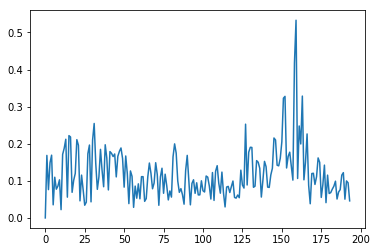

In [229]:
plt.plot(confounds.FramewiseDisplacement)